In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pickle, os
import pandas as pd
from glob import glob
import datetime as dt
from itertools import zip_longest
import utils
import seaborn as sn

def safe_int(value):
    try:
        return int(value)
    except ValueError: # only happens with the string "7-8"
        return 7 

def filter_keys(selected_keys, obj):
    keys = obj.keys()
    for k in list(keys):
        if k not in selected_keys:
            del obj[k]

# Contents <a name="contents">
## Plots
- [JM149-ELT-2-RNAi](#JM149-ELT-2-RNAi)
- [JM149-L4440](#JM149-L4440)
- [JM259-ELT-2-RNAi](#JM259-ELT-2-RNAi)
- [JM259-L4440](#JM259-L4440)

# Read in pickle files produced by segmentation_c_elegans_3d.py

### Retain only the processed images and the spot dataframe

In [2]:
script_mtime = os.stat('viewResults.ipynb').st_mtime
alldata = {}

pickfiles = glob("segmentation/JM*/*/*/*/*.pick")
print(len(pickfiles))

os.path.basename(pickfiles[0])

for pick in pickfiles:
    
    pick_mtime = os.stat(pick).st_mtime
    if pick_mtime > script_mtime:
        print("changed", end=" ")
    key, obj, data = utils.load_data(pick)

    filter_keys(['rotated_cropped_segmented_image','rotated_cropped_masked_GFP','dataframe'], obj)
    alldata.update(data)

keys = alldata.keys()
print("Total number read in:", len(keys))

# divide out into groups
JM149_L4440 = {}
JM149_ELT2 = {}
JM259_L4440 = {}
JM259_ELT2 = {}
for k in keys:
    genotype, rep, stage, rnai, wormnum = k
    if genotype == 'JM149':
        if rnai == 'L4440_RNAi':
            JM149_L4440[k] = alldata[k]
        elif rnai == 'ELT-2_RNAi':
            JM149_ELT2[k] = alldata[k]
        elif rnai == 'L4440':
            JM149_L4440[k] = alldata[k]
        elif rnai == 'ELT-2':
            JM149_ELT2[k] = alldata[k]
        else:
            print("unexpected RNAi:", k)
    elif genotype == 'JM259':
        if rnai == 'L4440_RNAi':
            JM259_L4440[k] = alldata[k]
        elif rnai == 'ELT-2_RNAi':
            JM259_ELT2[k] = alldata[k]
        elif rnai == 'L4440':
            JM259_L4440[k] = alldata[k]
        elif rnai == 'ELT-2':
            JM259_ELT2[k] = alldata[k]
        else:
            print("unexpected RNAi:", k)
    else:
        print("unexpected genotype:", k)
    

print(f"{len(JM149_L4440)=}")
print(f"{len(JM259_L4440)=}")
print(f"{len(JM149_ELT2)=}")
print(f"{len(JM259_ELT2)=}")
for key in JM149_ELT2.keys():
    print(key)

116
reading pickle from JM149_1_L1_L4440_9.pick... done
reading pickle from JM149_1_L1_L4440_8.pick... done
reading pickle from JM149_1_L1_L4440_4.pick... done
reading pickle from JM149_1_L1_L4440_6.pick... done
reading pickle from JM149_1_L1_L4440_5.pick... done
reading pickle from JM149_1_L1_L4440_3.pick... done
reading pickle from JM149_1_L1_L4440_7.pick... done
reading pickle from JM149_1_L1_L4440_2.pick... done
reading pickle from JM149_1_L1_L4440_1.pick... done
reading pickle from JM149_1_L1_ELT-2_5.pick... done
reading pickle from JM149_1_L1_ELT-2_2.pick... done
reading pickle from JM149_1_L1_ELT-2_7.pick... done
reading pickle from JM149_1_L1_ELT-2_1.pick... done
reading pickle from JM149_1_L1_ELT-2_6.pick... done
reading pickle from JM149_1_L1_ELT-2_3.pick... done
reading pickle from JM149_1_L1_ELT-2_9.pick... done
reading pickle from JM149_1_L1_ELT-2_8.pick... done
reading pickle from JM149_1_L1_ELT-2_4.pick... done
reading pickle from JM149_3_L1_L4440_9.pick... done
reading 

In [3]:
len(JM259_ELT2)

29

[back to table of contents](#contents)

# Plots

## JM259/ELT2 RNAi <a name="JM259-ELT-2-RNAi">

In [4]:
to_plot_rep_1 = []
to_plot_rep_2 = []
to_plot_rep_3 = []

for k,v in JM259_ELT2.items():
    genotype, rep, stage, RNAi, worm = k
    if rep == "1":  to_plot_rep_1.append((k,v))
    if rep == "2":  to_plot_rep_2.append((k,v))
    if rep == "3":  to_plot_rep_3.append((k,v))

maxplotlen = 0
for to_plot in to_plot_rep_1, to_plot_rep_2, to_plot_rep_3:
    maxplotlen = max(maxplotlen, len(to_plot))
    try:
        to_plot.sort(key=lambda k: safe_int(k[0][4]))
    except:
        to_plot.sort(key=lambda k: k[0][4])

fig, ax = plt.subplots(maxplotlen,3,dpi = 1000, figsize=(13,10))
#plt.subplots_adjust(left=.2, right=.5, top=.5, bottom=0)
genotype, rep, stage, RNAi, worm = to_plot_rep_1[0][0]
fig.suptitle(f"{genotype} {RNAi}")
brightfield_plot_styles={'s': 1.5, 'alpha':1, 'linewidths':.5, 'facecolors': 'g', 'edgecolors': 'black' }
#gfp_plot_styles={'s': 1.5, 'alpha':.5, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'r' }
gfp_plot_styles={'s': 3, 'alpha':1, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'green' }
color_map = 'Greys_r'


skip = [] #[(0,6),(1,2)]

for i,wormset in enumerate(zip_longest(to_plot_rep_1, to_plot_rep_2, to_plot_rep_3)):
    for j,worm in enumerate(wormset):
        ax[i,j].axis('off') 
        ax[i,j].grid(False)
        
        if worm is None: 
            ax[i,j].set(title=f"{i},{j}")
            continue
         
        k,v = worm
        genotype, rep, stage, RNAi, wormnum = k 
        df_in_mask_rotated = v['dataframe'] 
        
        #ax[i,j].set(title=f"{i},{j},{rep=},{wormnum=}")
        ax[i,j].set(title=f"Rep{rep} Worm{wormnum}, nuclei found: {len(df_in_mask_rotated)}")
        if (j,i) in skip: continue
            

        
        rotated_cropped_segmented_image = v['rotated_cropped_segmented_image'] 
        rotated_cropped_masked_GFP = v['rotated_cropped_masked_GFP']

        #utils.annotate_spots(df_in_mask_rotated, rotated_cropped_segmented_image, ax=ax[i,j], plot_styles=brightfield_plot_styles)
        utils.annotate_spots(df_in_mask_rotated, rotated_cropped_masked_GFP, ax=ax[i,j], plot_styles=gfp_plot_styles)

plt.subplots_adjust(hspace=.6)
plt.show()


[back to table of contents](#contents)

## Plot JM259 L4440 <a name="JM259-L4440">

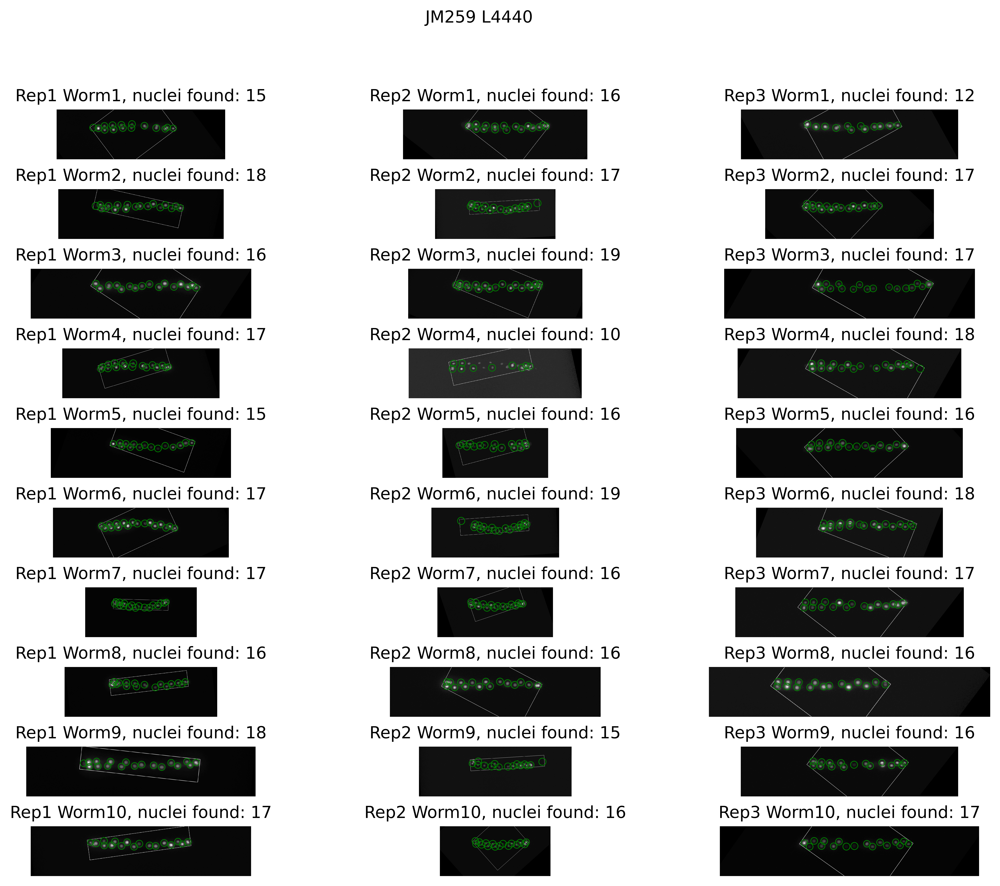

In [5]:
to_plot_rep_1 = []
to_plot_rep_2 = []
to_plot_rep_3 = []

for k,v in JM259_L4440.items():
    genotype, rep, stage, RNAi, worm = k
    if rep == "1":  to_plot_rep_1.append((k,v))
    if rep == "2":  to_plot_rep_2.append((k,v))
    if rep == "3":  to_plot_rep_3.append((k,v))

maxplotlen = 0
for to_plot in to_plot_rep_1, to_plot_rep_2, to_plot_rep_3:
    maxplotlen = max(maxplotlen, len(to_plot))
    try:
        to_plot.sort(key=lambda k: safe_int(k[0][4]))
    except:
        to_plot.sort(key=lambda k: k[0][4])

fig, ax = plt.subplots(maxplotlen,3,dpi = 600, figsize=(13,10))
#plt.subplots_adjust(left=.2, right=.5, top=.5, bottom=0)
genotype, rep, stage, RNAi, worm = to_plot_rep_1[0][0]
fig.suptitle(f"{genotype} {RNAi}")
brightfield_plot_styles={'s': 1.5, 'alpha':1, 'linewidths':.5, 'facecolors': 'g', 'edgecolors': 'black' }
#gfp_plot_styles={'s': 1.5, 'alpha':.5, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'r' }
gfp_plot_styles={'s': 3, 'alpha':1, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'green' }
color_map = 'Greys_r'
from itertools import zip_longest

skip = []

for i,wormset in enumerate(zip_longest(to_plot_rep_1, to_plot_rep_2, to_plot_rep_3)):
    for j,worm in enumerate(wormset):
        ax[i,j].axis('off') 
        ax[i,j].grid(False)
        
        if worm is None: 
            ax[i,j].set(title=f"{i},{j}")
            continue
         
 
        k,v = worm
        df_in_mask_rotated = v['dataframe']  
        genotype, rep, stage, RNAi, wormnum = k 
        
        #ax[i,j].set(title=f"{i},{j},{rep=},{wormnum=}")
        ax[i,j].set(title=f"Rep{rep} Worm{wormnum}, nuclei found: {len(df_in_mask_rotated)}")
        if (j,i) in skip: continue
            

        rotated_cropped_segmented_image = v['rotated_cropped_segmented_image'] 
        rotated_cropped_masked_GFP = v['rotated_cropped_masked_GFP']

        #utils.annotate_spots(df_in_mask_rotated, rotated_cropped_segmented_image, ax=ax[i,j], plot_styles=brightfield_plot_styles)
        utils.annotate_spots(df_in_mask_rotated, rotated_cropped_masked_GFP, ax=ax[i,j], plot_styles=gfp_plot_styles)

        plt.subplots_adjust(hspace=.6)
plt.show()


[back to table of contents](#contents)

## Plot JM149 L4440 <a name="JM149-L4440">

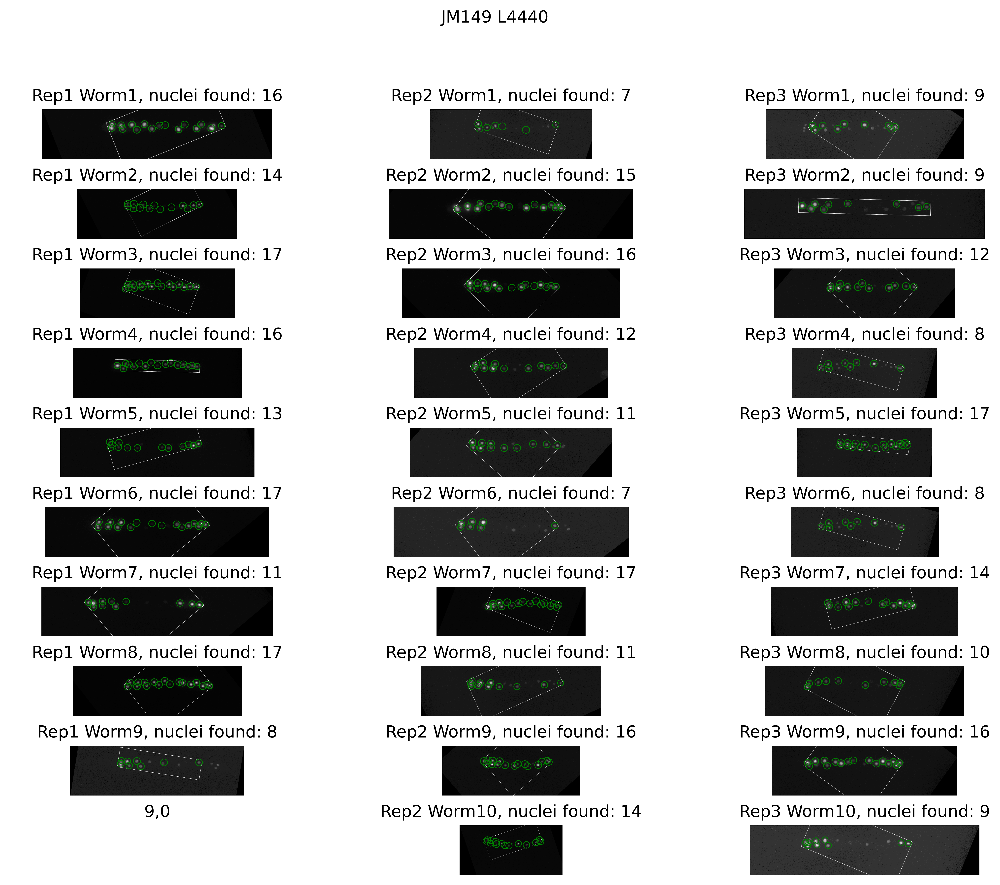

In [6]:
to_plot_rep_1 = []
to_plot_rep_2 = []
to_plot_rep_3 = []

for k,v in JM149_L4440.items():
    genotype, rep, stage, RNAi, worm = k
    if rep == "1":  to_plot_rep_1.append((k,v))
    if rep == "2":  to_plot_rep_2.append((k,v))
    if rep == "3":  to_plot_rep_3.append((k,v))

maxplotlen = 0
for to_plot in to_plot_rep_1, to_plot_rep_2, to_plot_rep_3:
    maxplotlen = max(maxplotlen, len(to_plot))
    try:
        to_plot.sort(key=lambda k: safe_int(k[0][4]))
    except:
        to_plot.sort(key=lambda k: k[0][4])

fig, ax = plt.subplots(maxplotlen,3,dpi = 600, figsize=(13,10))
#plt.subplots_adjust(left=.2, right=.5, top=.5, bottom=0)
genotype, rep, stage, RNAi, worm = to_plot_rep_1[0][0]
fig.suptitle(f"{genotype} {RNAi}")
brightfield_plot_styles={'s': 1.5, 'alpha':1, 'linewidths':.5, 'facecolors': 'g', 'edgecolors': 'black' }
#gfp_plot_styles={'s': 1.5, 'alpha':.5, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'r' }
gfp_plot_styles={'s': 3, 'alpha':1, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'green' }

color_map = 'Greys_r'


skip = []

for i,wormset in enumerate(zip_longest(to_plot_rep_1, to_plot_rep_2, to_plot_rep_3)):
    for j,worm in enumerate(wormset):
        ax[i,j].axis('off') 
        ax[i,j].grid(False)
        
        if worm is None: 
            ax[i,j].set(title=f"{i},{j}")
            continue
         
        k,v = worm
        df_in_mask_rotated = v['dataframe'] 
        genotype, rep, stage, RNAi, wormnum = k 
        
        #ax[i,j].set(title=f"{i},{j},{rep=},{wormnum=}")
        ax[i,j].set(title=f"Rep{rep} Worm{wormnum}, nuclei found: {len(df_in_mask_rotated)}")
        if (j,i) in skip: continue
            


        rotated_cropped_segmented_image = v['rotated_cropped_segmented_image'] 
        rotated_cropped_masked_GFP = v['rotated_cropped_masked_GFP']

        #utils.annotate_spots(df_in_mask_rotated, rotated_cropped_segmented_image, ax=ax[i,j], plot_styles=brightfield_plot_styles)
        utils.annotate_spots(df_in_mask_rotated, rotated_cropped_masked_GFP, ax=ax[i,j], plot_styles=gfp_plot_styles)

plt.subplots_adjust(hspace=.6)
plt.show()

[back to table of contents](#contents)

## Plot JM149 ELT-2 RNAi <a name="JM149-ELT-2-RNAi">

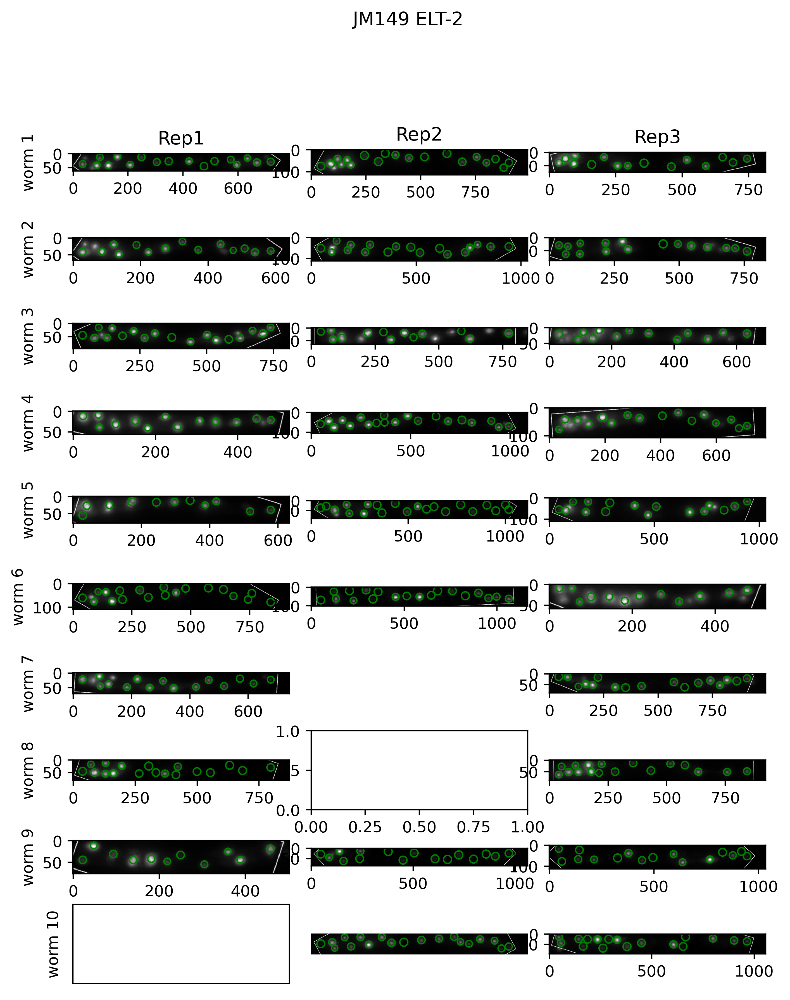

In [16]:
to_plot_rep_1 = []
to_plot_rep_2 = []
to_plot_rep_3 = []

for k,v in JM149_ELT2.items():
    genotype, rep, stage, RNAi, worm = k
    if rep == "1":  to_plot_rep_1.append((k,v))
    if rep == "2":  to_plot_rep_2.append((k,v))
    if rep == "3":  to_plot_rep_3.append((k,v))

maxplotlen = 0
for to_plot in to_plot_rep_1, to_plot_rep_2, to_plot_rep_3:
    maxplotlen = max(maxplotlen, len(to_plot))
    try:
        to_plot.sort(key=lambda k: safe_int(k[0][4]))
    except:
        to_plot.sort(key=lambda k: k[0][4])

fig, ax = plt.subplots(maxplotlen,3,dpi = 400, figsize=(8,10)) # ,sharey=True
#plt.subplots_adjust(left=.2, right=.5, top=.5, bottom=0)
genotype, rep, stage, RNAi, worm = to_plot_rep_1[0][0]
fig.suptitle(f"{genotype} {RNAi}")
brightfield_plot_styles={'s': 1.5, 'alpha':1, 'linewidths':.5, 'facecolors': 'g', 'edgecolors': 'black' }
gfp_plot_styles={'s': 1.5, 'alpha':.5, 'linewidths':.5, 'facecolors': 'none', 'edgecolors': 'r' }
gfp_plot_styles={'s': 3, 'alpha':1, 'linewidths':.9, 'facecolors': 'none', 'edgecolors': 'green' }
color_map = 'Greys_r'
plot_GFP = True



skip = [(1,6)]

for i,wormset in enumerate(zip_longest(to_plot_rep_1, to_plot_rep_2, to_plot_rep_3)):
    for j,worm in enumerate(wormset):
 
        ax[i,j].grid(False)
    
        if j == 0:
            ax[i,j].set_anchor('W')
        elif j == 1:
            ax[i,j].set_anchor('C')
        else:
            ax[i,j].set_anchor('E')
            
        if worm is None: 
            #ax[i,j].set(title=f"{i},{j}")
            #ax[i,j].axis('off') 
            ax[i,j].set_yticklabels([])
            ax[i,j].set_yticks([])
            ax[i,j].set_xticklabels([])
            ax[i,j].set_xticks([])
            
            if j == 0:
                ax[i,j].axis('on') 
                ax[i,j].set_ylabel(f'worm {i+1}')
            else:
                ax[i,j].axis('off')
                
            continue
            
        k,v = worm
        df_in_mask_rotated = v['dataframe'] 
        genotype, rep, stage, RNAi, wormnum = k 
        I = safe_int(wormnum) - 1
        if i == 0: 
            ax[i,j].set(title=f"Rep{rep}")

        if j == 0:
            ax[i,j].set_ylabel(f'worm {wormnum}')
            
        #ax[i,j].set(title=f"{i},{j},{rep=},{wormnum=}")
        #ax[I,j].set(title=f"Rep{rep} Worm{wormnum}, nuclei found: {len(df_in_mask_rotated)}")
        if (j,i) in skip: 
            ax[i,j].axis('off')
            continue
        else:
            ax[i,j].axis('on')
        """
        if safe_int(wormnum) != (i + 1):
            ax[i,j].axis('off')
            print(f"{i=}, {rep=}, {wormnum=}")
        else:
            ax[i,j].axis('on')
        """

        rotated_cropped_segmented_image = v['rotated_cropped_segmented_image'] 
        rotated_cropped_masked_GFP = v['rotated_cropped_masked_GFP']
        
        if plot_GFP:
            utils.annotate_spots(df_in_mask_rotated, rotated_cropped_masked_GFP, ax=ax[I,j], plot_styles=gfp_plot_styles, crop_to_points = True)
        else:
            utils.annotate_spots(df_in_mask_rotated, rotated_cropped_segmented_image, ax=ax[I,j], plot_styles=brightfield_plot_styles, crop_to_points = False)


plt.subplots_adjust(hspace=.1, wspace=.1)
plt.show()

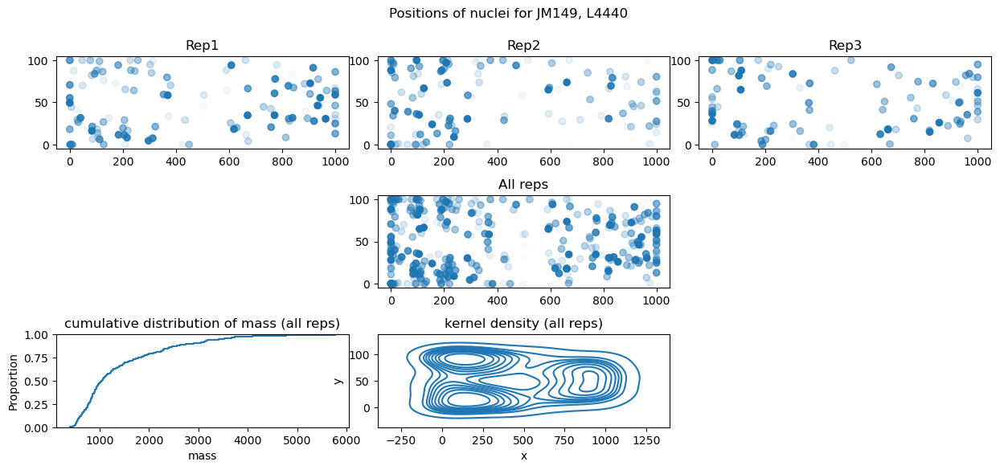

In [8]:
import math
def scale_0_1(x):
    #return x
    xmin = min(x)
    xmax = max(x)
    xrange = xmax - xmin
    x_scaled = (x - xmin)/xrange
    return x_scaled

rep1 = pd.DataFrame({'x': [], 'y': [], 'm': [], 'mass': []})
rep2 = pd.DataFrame({'x': [], 'y': [], 'm': [], 'mass': []})
rep3 = pd.DataFrame({'x': [], 'y': [], 'm': [], 'mass': []})


fig, ax = plt.subplots(3,3,figsize=(15,6))
fig.suptitle("Positions of nuclei for JM149, L4440")

for k,v in JM149_L4440.items():
    genotype, rep, stage, RNAi, worm = k

    
    df = v['dataframe']
    x = df.loc[:,'x']
    y = df.loc[:,'y']
    m = scale_0_1(df['mass'] ) 
    mass = df['mass']
    x_scaled = scale_0_1(x) * 1000
    y_scaled = scale_0_1(y) * 100
    
    if rep == "1":  
        rep1 = pd.concat([rep1, pd.DataFrame({'x': x_scaled, 'y':y_scaled, 'm': m, 'mass': mass })])
    if rep == "2":
        rep2 = pd.concat([rep2, pd.DataFrame({'x': x_scaled, 'y':y_scaled, 'm': m, 'mass': mass  })])
    if rep == "3":
        rep3 = pd.concat([rep3, pd.DataFrame({'x': x_scaled, 'y':y_scaled, 'm': m, 'mass': mass  })])
    
all = pd.concat([rep1,rep2,rep3])

ax[0,0].set(title="Rep1")
ax[0,1].set(title="Rep2")
ax[0,2].set(title="Rep3")

#ax[0].scatter(rep1.loc[:,'x'],rep1.loc[:,'y'])
ax[0,0].scatter(rep1['x'],rep1['y'], alpha = rep1['m'])
ax[0,1].scatter(rep2['x'],rep2['y'], alpha = rep2['m'])
ax[0,2].scatter(rep3['x'],rep3['y'], alpha = rep3['m'])
ax[1,1].scatter(all['x'], all['y'], alpha=all['m']); ax[1,1].set(title="All reps")
#ax[1,1].set_ylim(0,350)

# kdeplot
q_s = np.quantile(all['mass'],[.25,.5,.75,.99])
all['quartile'] = "q1"
all.loc[(all["mass"] >= q_s[0]) & (all["mass"] < q_s[1]), 'quartile'] = 'q2'
all.loc[(all["mass"] >= q_s[1]) & (all["mass"] < q_s[2]), 'quartile'] = 'q3'
all.loc[all["mass"] >= q_s[2], 'quartile'] = 'q4'

ax[2,0].set(title="cumulative distribution of mass (all reps)")
sn.ecdfplot(data=all['mass'], ax=ax[2,0])

all['hilow'] = 'low'
all.loc[ all["mass"] >= q_s[3], "hilow" ] = "hi"

ax[2,1].set(title="kernel density (all reps)")
sn.kdeplot(data=all, x='x', y='y', ax=ax[2,1],fill=False)# hue="quartile",
plt.subplots_adjust(hspace=.5, wspace=.1)

for axx in [ ax[1,0], ax[1,2], ax[2,2] ]:
    axx.axis("off")

plt.show()


In [9]:
q_s = np.quantile(all['mass'],[.25,.5,.75])
q_s

array([ 777.16246314, 1045.35929599, 1802.18975533])

In [10]:
all['quartile'] = "q1"
all.loc[(all["mass"] >= q_s[0]) & (all["mass"] < q_s[1]), 'quartile'] = 'q2'
all.loc[(all["mass"] >= q_s[1]) & (all["mass"] < q_s[2]), 'quartile'] = 'q3'
all.loc[all["mass"] >= q_s[2], 'quartile'] = 'q4'

In [11]:
all.head()

,x,y,m,mass,quartile,hilow
267,0.000000,55.400657,0.782499,919.127773,q2,low
271,6.734520,0.000000,0.028616,529.078997,q1,low
314,83.246519,16.276191,1.000000,1031.659579,q2,low
328,108.015841,89.064443,0.136395,584.842600,q1,low
370,205.294016,11.270915,0.816686,936.815342,q2,low
